<a href="https://colab.research.google.com/github/samanthajmichael/ml_project/blob/main/notebooks/Data_Cleaning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
%%capture
!pip install tensorflow ffmpeg-python

In [ ]:
import os
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from tqdm import tqdm

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
from google.colab import auth
from google.colab import files
from googleapiclient.discovery import build
from googleapiclient.http import MediaIoBaseDownload
import io

# Authenticate
auth.authenticate_user()

# Build the Drive API client
drive_service = build('drive', 'v3')

def list_files(query="mimeType='video/mp4'"):
    results = drive_service.files().list(
        q=query,
        spaces='drive',
        fields="nextPageToken, files(id, name, mimeType)",
        pageSize=20).execute()
    return results.get('files', [])

def download_file(file_id, file_name):
    request = drive_service.files().get_media(fileId=file_id)
    fh = io.BytesIO()
    downloader = MediaIoBaseDownload(fh, request)
    done = False
    while done is False:
        status, done = downloader.next_chunk()
        print(f"Download {int(status.progress() * 100)}%")

    fh.seek(0)
    with open(file_name, 'wb') as f:
        f.write(fh.read())
    return f"/content/{file_name}"

# List MP4 files
print("Searching for MP4 files in your Google Drive (including shared files)...")
files = list_files()

if not files:
    print('No MP4 files found.')
else:
    print('MP4 files:')
    for i, file in enumerate(files):
        print(f"{i+1}. {file['name']} ({file['id']})")

    # Let user choose a file
    choice = int(input("Enter the number of the file you want to process: ")) - 1
    if 0 <= choice < len(files):
        selected_file = files[choice]
        print(f"You selected: {selected_file['name']}")

        # Download the file
        file_path = download_file(selected_file['id'], selected_file['name'])
        print(f"File downloaded to: {file_path}")

        # Now you can use this file_path in your colab_main function
        # colab_main(file_path)
    else:
        print("Invalid choice.")

Searching for MP4 files in your Google Drive (including shared files)...
MP4 files:
1. To.Kill.a.Mockingbird.1962.720p.BrRip.264.YIFY.mp4 (1g6VJ6SeoXJ9ytSdliyViPbS1Hw4Vzk11)
2. SP215_1080_05.14.mp4 (1OK656HJm6Lxm7AmYhDmGq-sU4FJfrMyy)
Enter the number of the file you want to process: 1
You selected: To.Kill.a.Mockingbird.1962.720p.BrRip.264.YIFY.mp4
Download 12%
Download 25%
Download 37%
Download 50%
Download 62%
Download 75%
Download 87%
Download 100%
File downloaded to: /content/To.Kill.a.Mockingbird.1962.720p.BrRip.264.YIFY.mp4


In [ ]:
!pip install opencv-python matplotlib


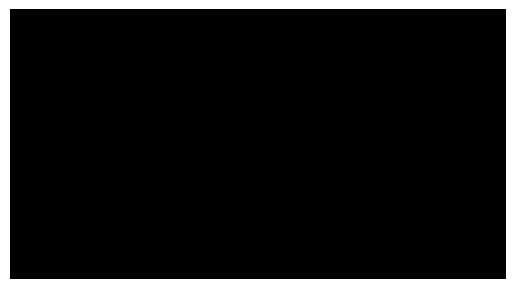

In [ ]:
import cv2
import matplotlib.pyplot as plt

video_path = '/content/To.Kill.a.Mockingbird.1962.720p.BrRip.264.YIFY.mp4'
cap = cv2.VideoCapture(video_path)

if not cap.isOpened():
    print("Error.")
else:
    ret, frame = cap.read()

    if ret:
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

        plt.imshow(frame_rgb)
        plt.axis('off')
        plt.show()
    else:
        print("Errorrrrrrr.")

cap.release()


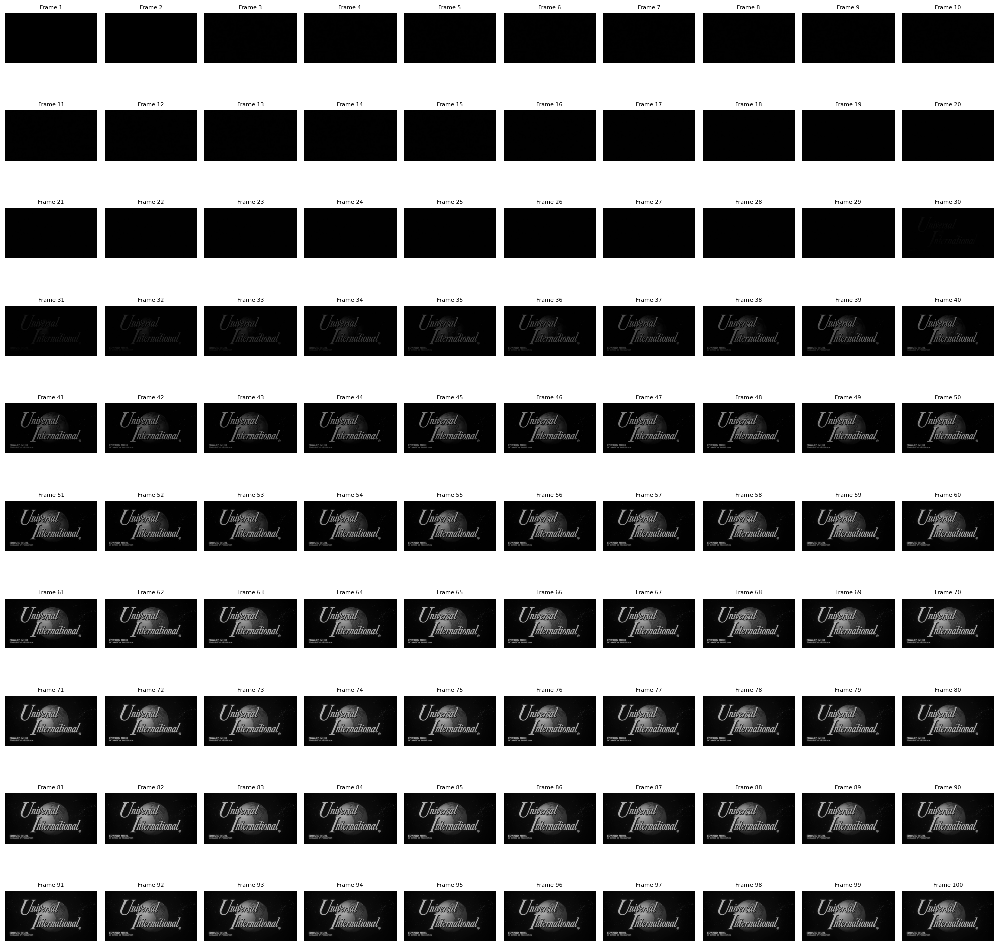

In [ ]:
cap = cv2.VideoCapture(video_path)

total_frames = 10

for grid_start in range(0, total_frames, 100):
    fig, axes = plt.subplots(10, 10, figsize=(20, 20))
    axes = axes.flatten()

    for i in range(100):
        ret, frame = cap.read()
        if not ret:
            break
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        axes[i].imshow(frame_rgb)
        axes[i].axis('off')
        axes[i].set_title(f'Frame {grid_start + i + 1}', fontsize=8)

    plt.tight_layout()
    plt.show()

cap.release()

In [ ]:
#Memory efficient cleaning process using chunking - set chunk size appropriately in the clean_video function

def count_frames(video_path):
    cap = cv2.VideoCapture(video_path)
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    cap.release()
    return total_frames

def is_blank_frame(frame, tolerance=10, min_contour_area=100):
    if len(frame.shape) == 3:
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    else:
        gray = frame

    # Check if the frame is entirely black or white within the tolerance
    if np.all(gray <= tolerance) or np.all(gray >= 255 - tolerance):
        return True

    # If not, check for significant content using contour detection
    _, thresh = cv2.threshold(gray, tolerance, 255, cv2.THRESH_BINARY)
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    for contour in contours:
        if cv2.contourArea(contour) > min_contour_area:
            return False  # Found significant content

    return True  # No significant content found

# edit the chunk size as you see fit
def clean_video(video_path, output_path, tolerance=10, min_contour_area=100, chunk_size=1000):
    cap = cv2.VideoCapture(video_path)

    if not cap.isOpened():
        raise ValueError(f"Error: Could not open video file {video_path}")

    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = int(cap.get(cv2.CAP_PROP_FPS))
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

    if not out.isOpened():
        raise ValueError(f"Error: Could not create output video file {output_path}")

    frames_kept = 0
    frames_removed = 0

    with tqdm(total=total_frames, desc="Processing frames") as pbar:
        while True:
            ret, frame = cap.read()
            if not ret:
                break

            if not is_blank_frame(frame, tolerance, min_contour_area):
                out.write(frame)
                frames_kept += 1

            else:
                frames_removed += 1

            pbar.update(1)

    cap.release()
    out.release()
    print(f"Video processing completed.")
    print(f"Frames Kept: {frames_kept}/{total_frames}")
    print(f"Frames removed: {frames_removed}/{total_frames}")
    print(f"Cleaned video saved to: {os.path.abspath(output_path)}")

    if os.path.exists(output_path):
        print(f"File size: {os.path.getsize(output_path) / (1024*1024):.2f} MB")
    else:
        print("Warning: Output file not found at the specified path.")

def display_sample_frames(video_path, num_samples=10):
    cap = cv2.VideoCapture(video_path)
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

    sample_indices = np.linspace(0, total_frames - 1, num_samples, dtype=int)

    fig, axes = plt.subplots(2, 5, figsize=(20, 8))
    axes = axes.flatten()

    for i, frame_idx in enumerate(sample_indices):
        cap.set(cv2.CAP_PROP_POS_FRAMES, frame_idx)
        ret, frame = cap.read()
        if ret:
            if len(frame.shape) == 3:
                frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            else:
                frame_rgb = cv2.cvtColor(frame, cv2.COLOR_GRAY2RGB)
            axes[i].imshow(frame_rgb)
            axes[i].axis('off')
            axes[i].set_title(f'Frame {frame_idx}', fontsize=8)

    plt.tight_layout()
    plt.show()
    cap.release()

def test_tolerance(video_path, tolerances=[5, 10, 15, 20], min_contour_area=100):
    cap = cv2.VideoCapture(video_path)
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    sample_indices = np.linspace(0, total_frames - 1, 5, dtype=int)

    for tolerance in tolerances:
        fig, axes = plt.subplots(1, 5, figsize=(20, 4))
        fig.suptitle(f'Tolerance: {tolerance}', fontsize=16)

        for i, frame_idx in enumerate(sample_indices):
            cap.set(cv2.CAP_PROP_POS_FRAMES, frame_idx)
            ret, frame = cap.read()
            if ret:
                if len(frame.shape) == 3:
                    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
                else:
                    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_GRAY2RGB)
                axes[i].imshow(frame_rgb)
                axes[i].axis('off')
                is_blank = is_blank_frame(frame, tolerance, min_contour_area)
                color = 'red' if is_blank else 'green'
                axes[i].set_title(f'Frame {frame_idx}\nBlank: {is_blank}', fontsize=8, color=color)

        plt.tight_layout()
        plt.show()

    cap.release()

Total frames in the video: 185832


Processing frames: 100%|██████████| 185832/185832 [24:51<00:00, 124.57it/s]


Video processing completed. Kept 185680/185832 frames.
Cleaned video saved to: /content/cleaned_video.mp4
File size: 2639.70 MB
Cleaned video file details:
Path: /content/cleaned_video.mp4
Size: 2639.70 MB


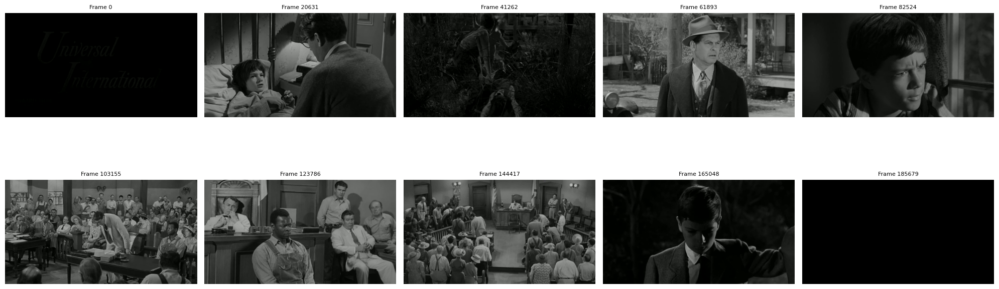

In [ ]:
# Usage
# using the predefined video_path from before
output_path = '/content/cleaned_video.mp4'

# Ensure the output directory exists
os.makedirs(os.path.dirname(output_path), exist_ok=True)

# Count and display the total number of frames
total_frames = count_frames(video_path)
print(f"Total frames in the video: {total_frames}")

# Clean the video
clean_video(video_path, output_path)

# Check if the file exists and display its properties
if os.path.exists(output_path):
    print(f"Cleaned video file details:")
    print(f"Path: {os.path.abspath(output_path)}")
    print(f"Size: {os.path.getsize(output_path) / (1024*1024):.2f} MB")
else:
    print(f"Warning: Cleaned video file not found at {output_path}")

# Display frames from the cleaned video
display_sample_frames(output_path)

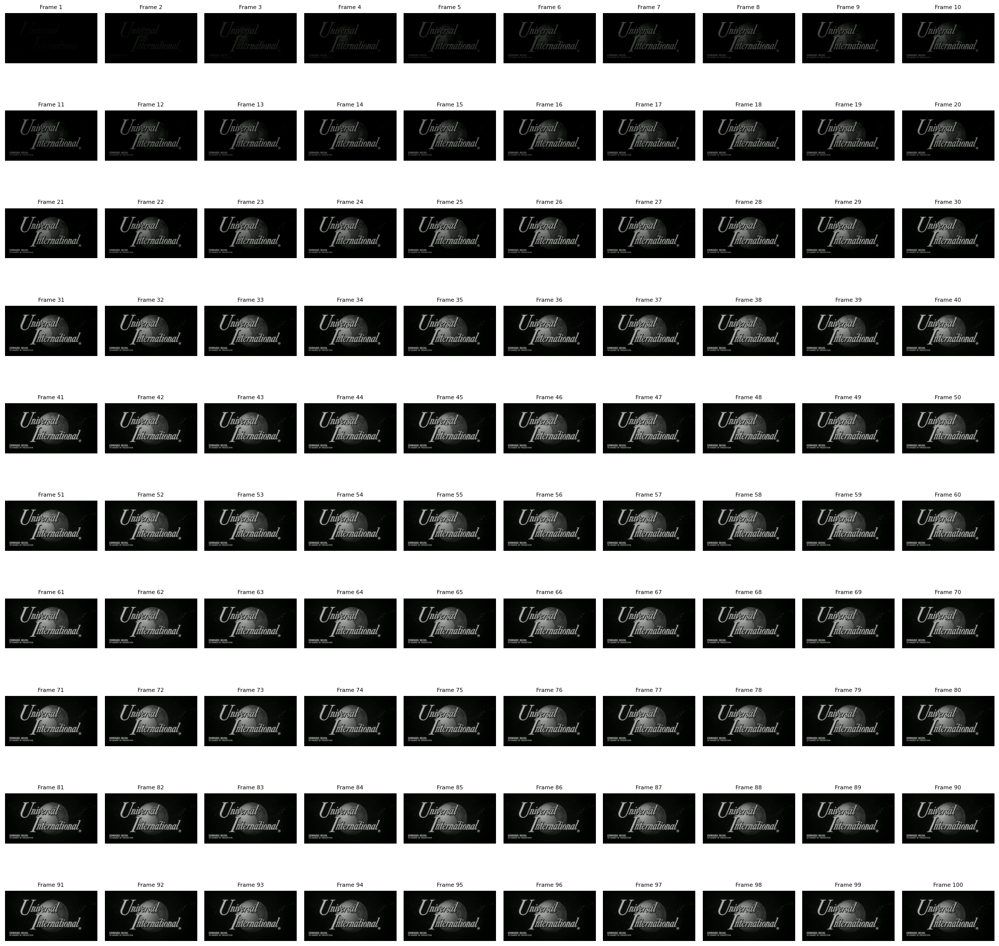

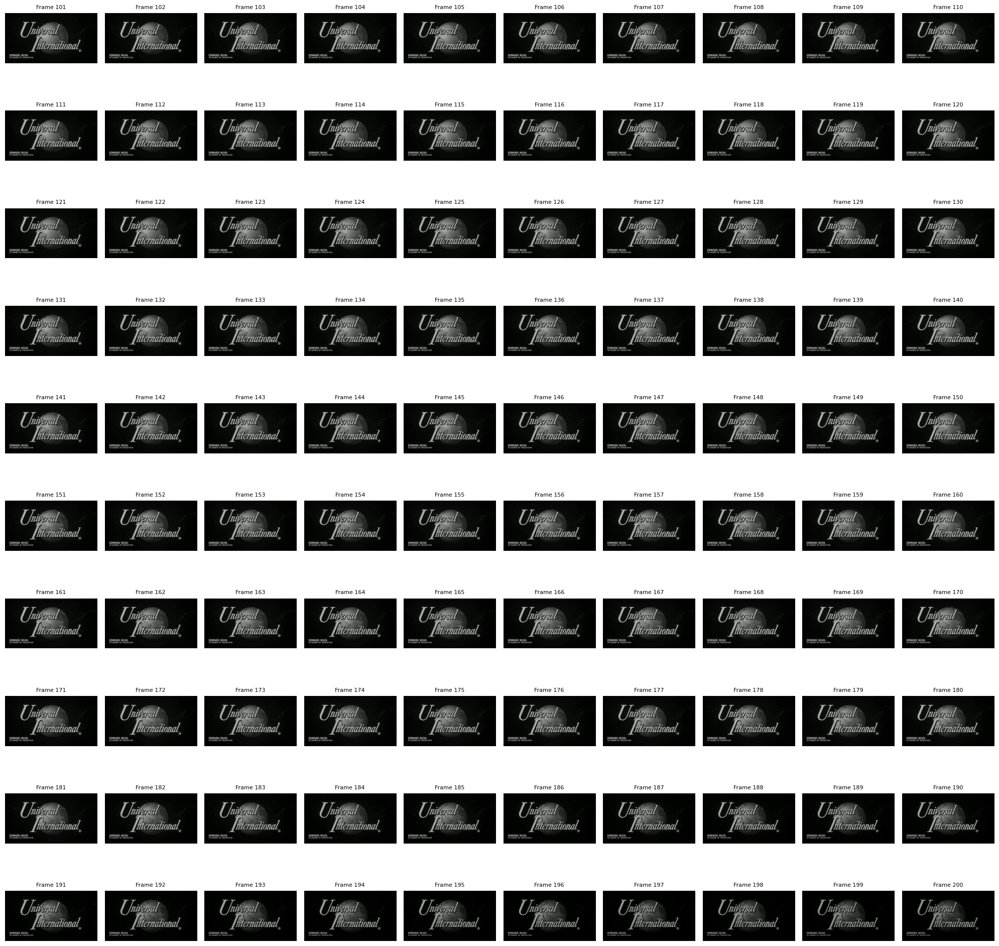

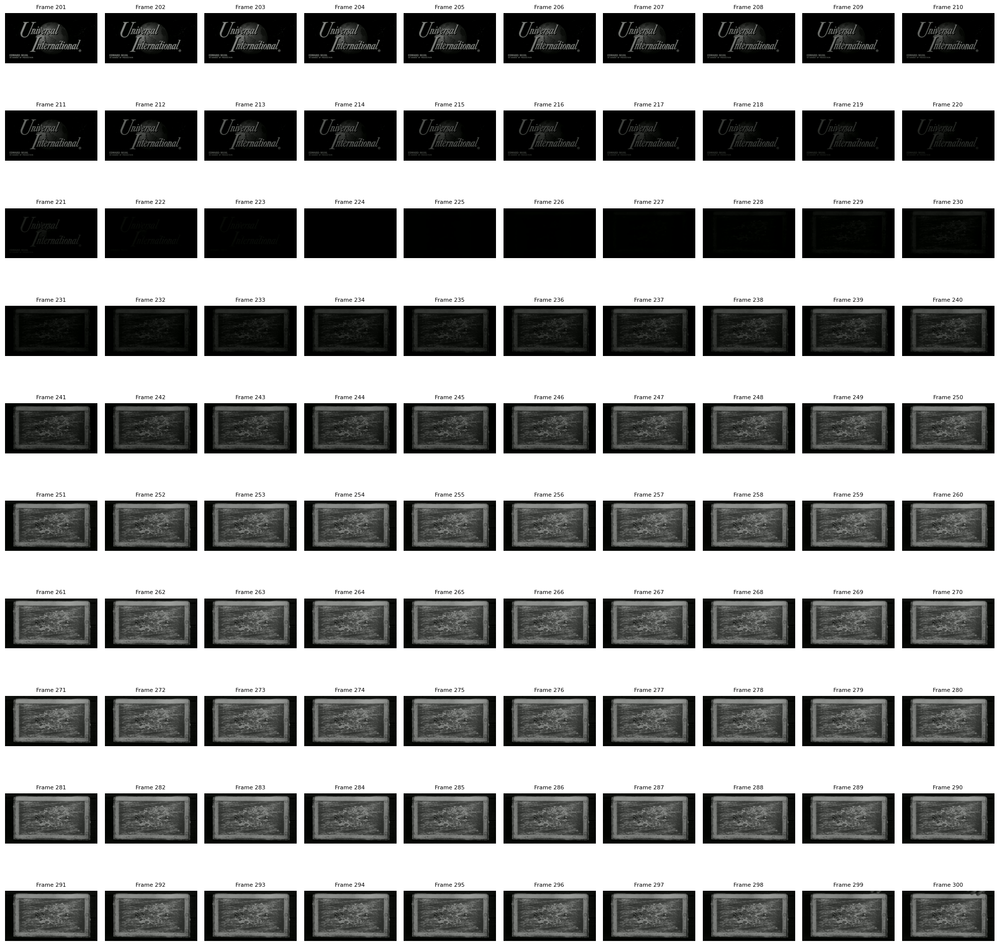

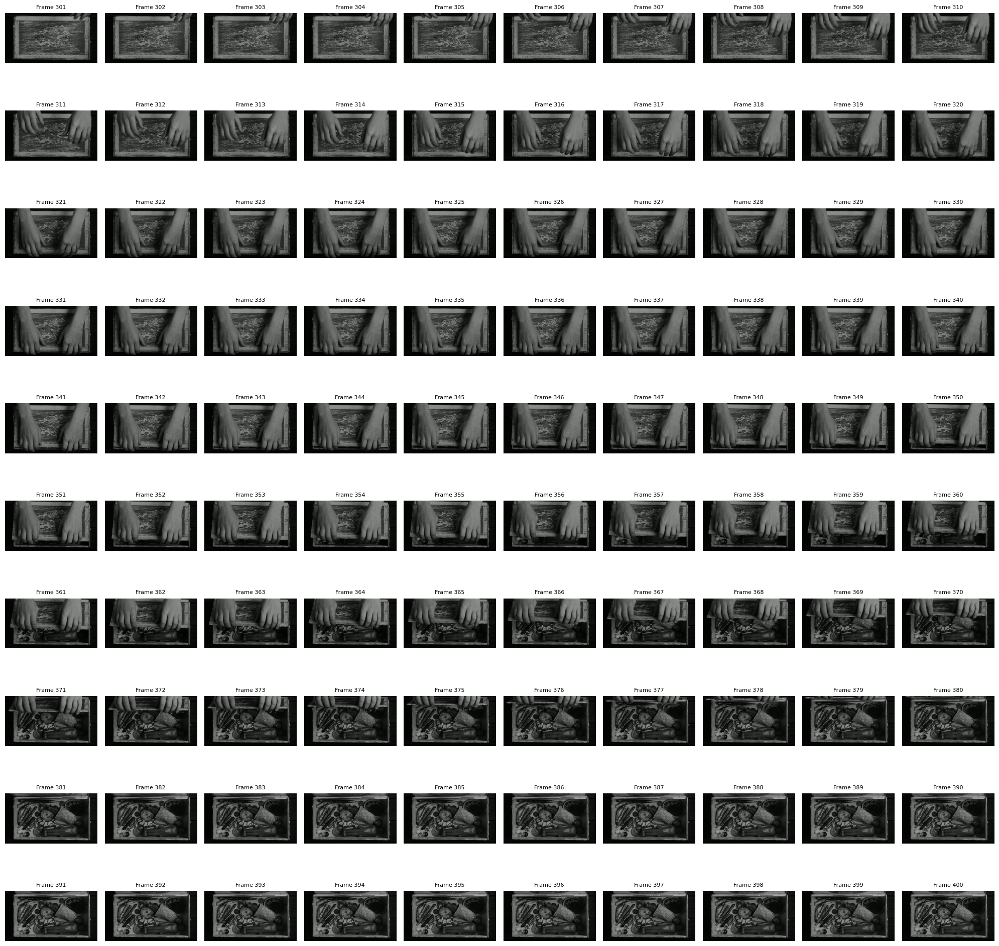

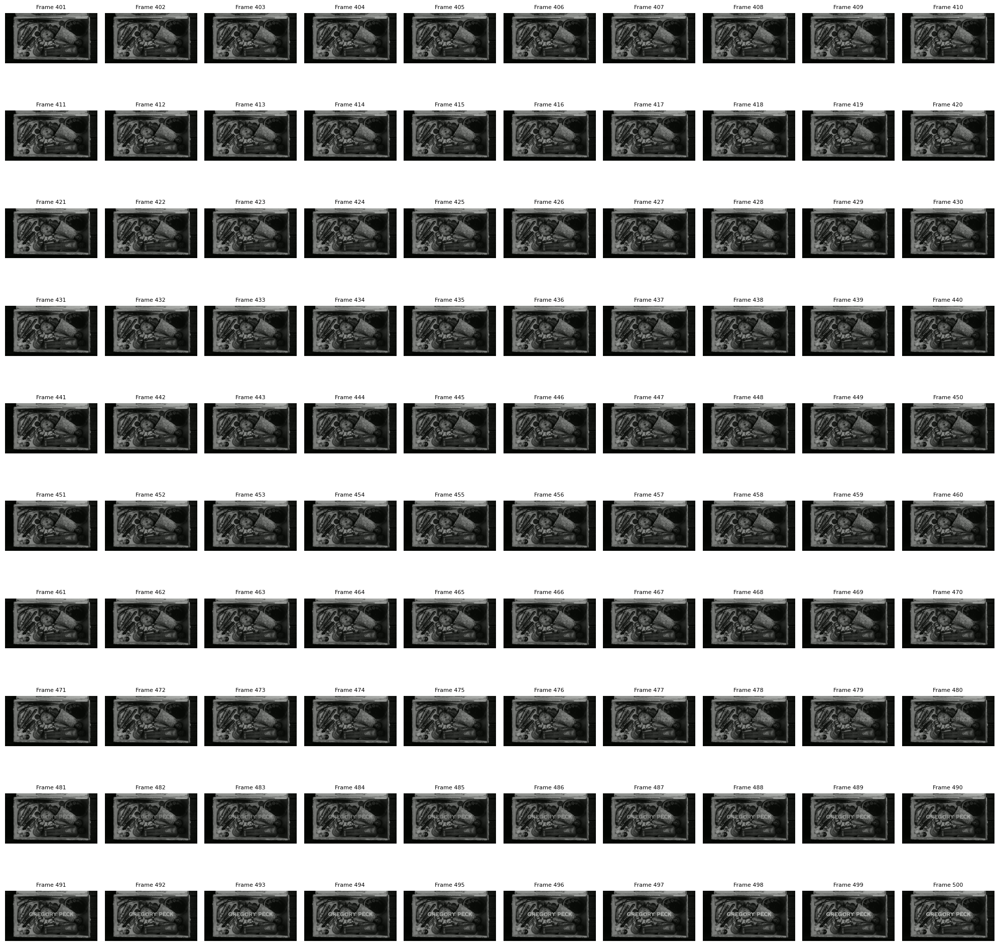

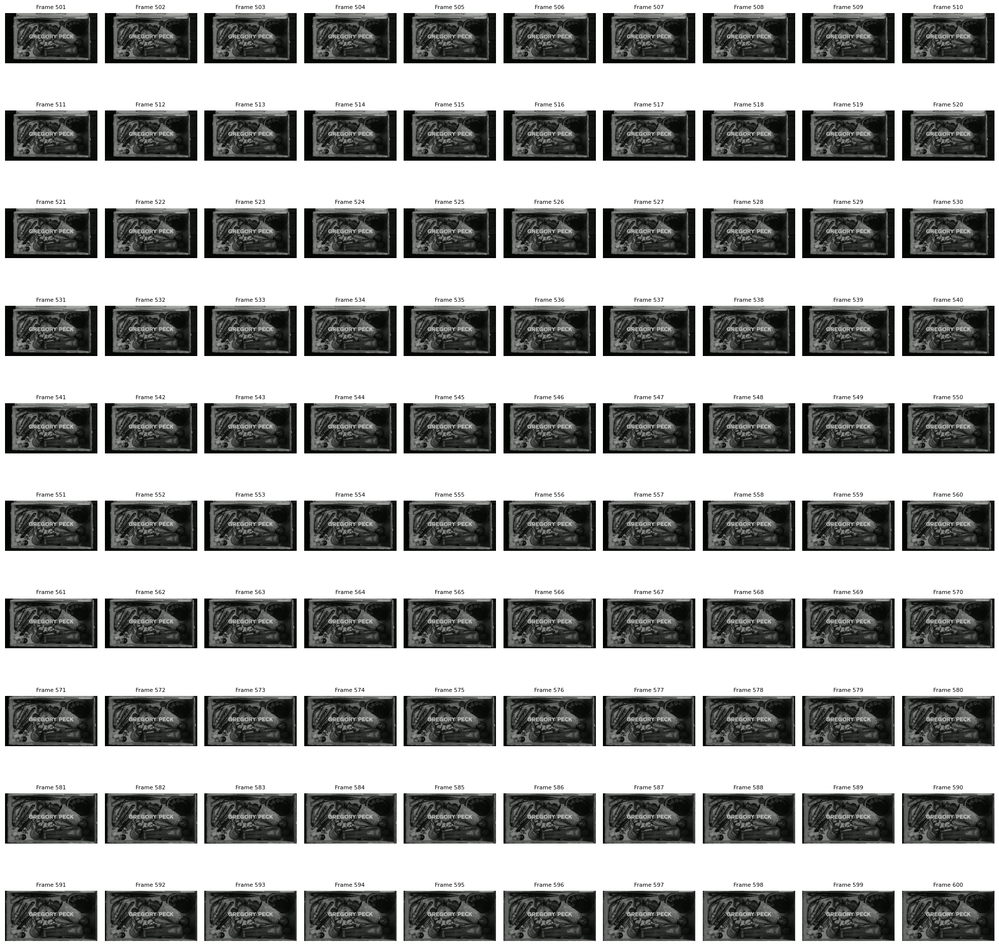

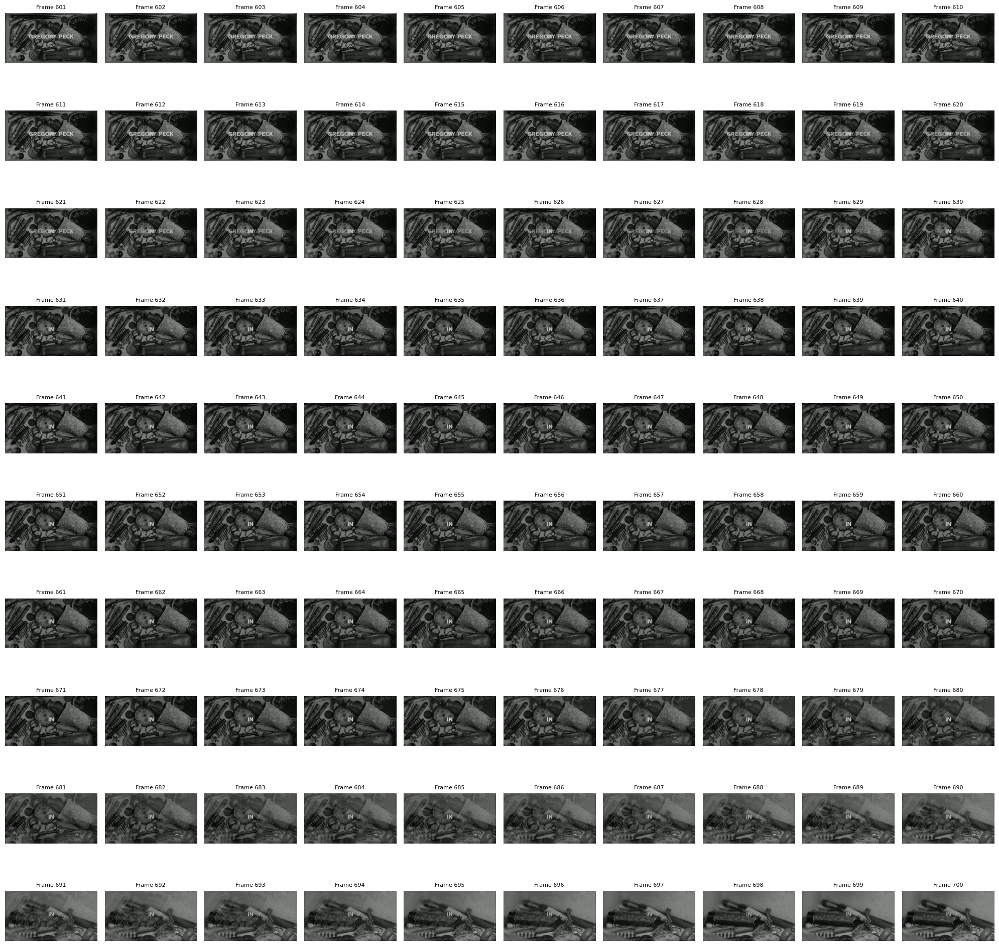

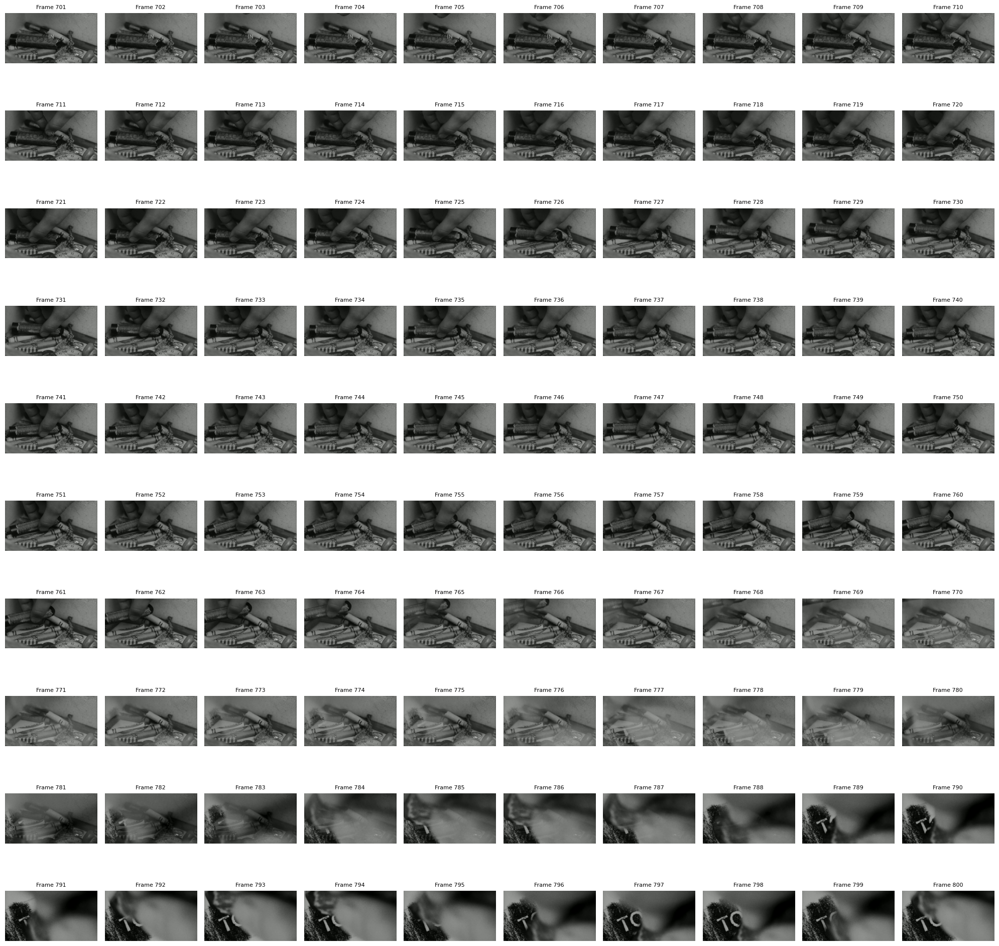

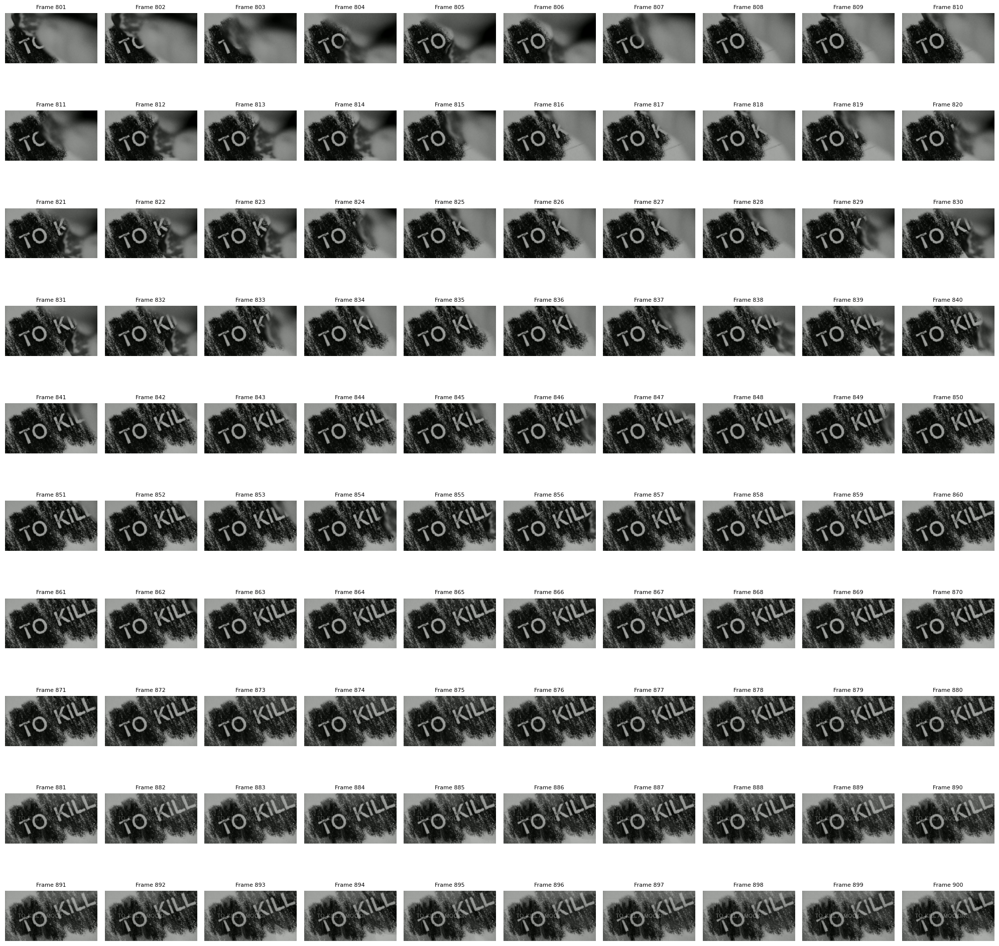

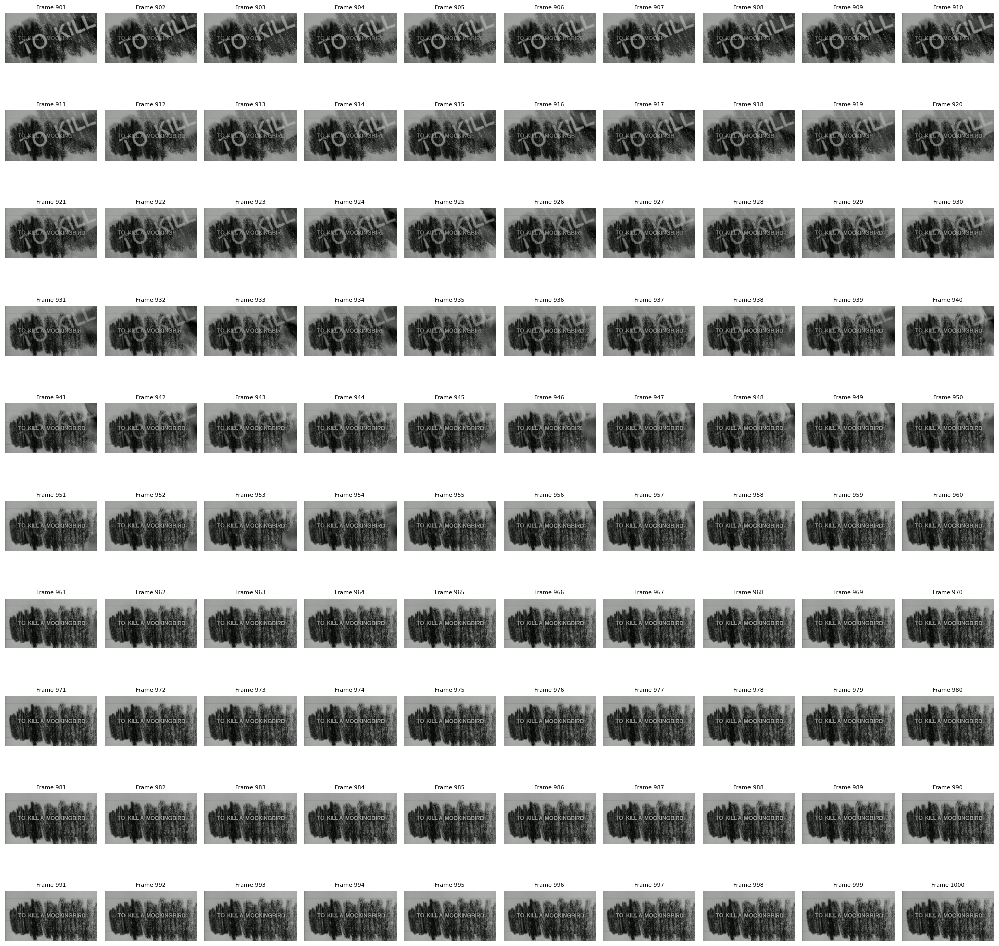

In [ ]:
cap_cleaned = cv2.VideoCapture(output_path)

total_frames = 1000

for grid_start in range(0, total_frames, 100):
    fig, axes = plt.subplots(10, 10, figsize=(20, 20))
    axes = axes.flatten()

    for i in range(100):
        ret, frame = cap_cleaned.read()
        if not ret:
            break
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        axes[i].imshow(frame_rgb)
        axes[i].axis('off')
        axes[i].set_title(f'Frame {grid_start + i + 1}', fontsize=8)

    plt.tight_layout()
    plt.show()

cap_cleaned.release()